# Import Libraries

In [1]:
# Data Manipulation
import pandas as pd
import numpy as np

# Data Visualization
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

# Data Preprocessing
import re
import nltk
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from nltk.tokenize import word_tokenize

# Modelling
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC

# Model Evaluation
from sklearn.metrics import confusion_matrix, classification_report

# Model Optimization
from sklearn.model_selection import GridSearchCV

# Extract to Pickle File
import pickle

# Database Import

In [2]:
df = pd.read_csv('news.csv')

# Exploratory Data Analysis (EDA)

In [3]:
df.head()

,Unnamed: 0,title,text,label
0,8476,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",FAKE
1,10294,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,FAKE
2,3608,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,REAL
3,10142,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",FAKE
4,875,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,REAL


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6335 entries, 0 to 6334
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  6335 non-null   int64 
 1   title       6335 non-null   object
 2   text        6335 non-null   object
 3   label       6335 non-null   object
dtypes: int64(1), object(3)
memory usage: 198.1+ KB


* Data terdiri dari 4 kolom
* Satu kolom bertipe numeric dan tiga kolom bertipe categoric

## Check missing value

In [5]:
df.isnull().sum()

,0
Unnamed: 0,0
title,0
text,0
label,0


* Tidak ada data yang null

## Check duplicate data

In [6]:
df.duplicated().sum()

0

* Tidak ada data duplikat

## Top 5 topic in dataset

In [7]:
df['title'].value_counts().head()

,count
title,
OnPolitics | 's politics blog,5
Michael Moore Owes Me $4.99,3
Hillary’s “Big Tent” is Obama’s “Grand Bargain” on Steroids,3
Get Ready For Civil Unrest: Survey Finds That Most Americans Are Concerned About Election Violence,3
The Dark Agenda Behind Globalism And Open Borders,2


## Count label

In [8]:
label = df['label']
label_count = label.value_counts()
label_count

,count
label,
REAL,3171
FAKE,3164


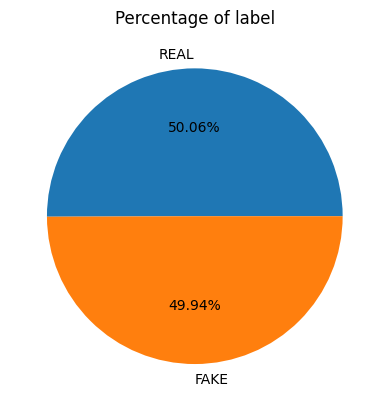

In [9]:
# View the label percentage using a pie chart
plt.pie(label_count, labels=label_count.index, autopct='%.2f%%')
plt.title('Percentage of label')
plt.show()

* Persentase data seimbang (50,06% : 49,94%)

# Data Preprocessing

In [10]:
# Copy dataset
df_temp = df.copy()

## Drop 'Unnamed: 0' colom

In [11]:
df_temp.drop(columns=['Unnamed: 0'], inplace=True)

In [12]:
df_temp.head()

,title,text,label
0,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",FAKE
1,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,FAKE
2,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,REAL
3,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",FAKE
4,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,REAL


## Merge 'title' and 'text'

In [13]:
df_temp['news'] = df_temp['title'] + ' ' + df_temp['text']
df_temp.head()

,title,text,label,news
0,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",FAKE,You Can Smell Hillary’s Fear Daniel Greenfield...
1,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,FAKE,Watch The Exact Moment Paul Ryan Committed Pol...
2,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,REAL,Kerry to go to Paris in gesture of sympathy U....
3,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",FAKE,Bernie supporters on Twitter erupt in anger ag...
4,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,REAL,The Battle of New York: Why This Primary Matte...


## Text cleaning

In [14]:
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [15]:
# Function to clean up text

from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

lemmatizer = WordNetLemmatizer()

def clean(text):
    text = str(text).lower()    # Lower case
    text = re.sub('https?://\S+|www\.\S+', '', text)    # Removing URL
    text = re.sub('[^a-zA-Z]',	'	',	text)  # Replacing	all	non-alphabetic	characters	with	a	space
    text = re.sub('[^\w\s]', '', text)    # Removing all punctuation
    text = word_tokenize(text)
    text = [lemmatizer.lemmatize(word,	pos	='v')	for	word	in	text	if	not	word	in	stopwords.words("english")]   # Lemmatization and removing stopwords
    text = ' '.join(text)
    return text

df_temp['clean_news'] = df_temp["news"].apply(clean)

In [16]:
df_temp.head()

,title,text,label,news,clean_news
0,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",FAKE,You Can Smell Hillary’s Fear Daniel Greenfield...,smell hillary fear daniel greenfield shillman ...
1,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,FAKE,Watch The Exact Moment Paul Ryan Committed Pol...,watch exact moment paul ryan commit political ...
2,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,REAL,Kerry to go to Paris in gesture of sympathy U....,kerry go paris gesture sympathy u secretary st...
3,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",FAKE,Bernie supporters on Twitter erupt in anger ag...,bernie supporters twitter erupt anger dnc try ...
4,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,REAL,The Battle of New York: Why This Primary Matte...,battle new york primary matter primary day new...


## Word Cloud after joining and cleaning title and text

### WordCloud of Real News

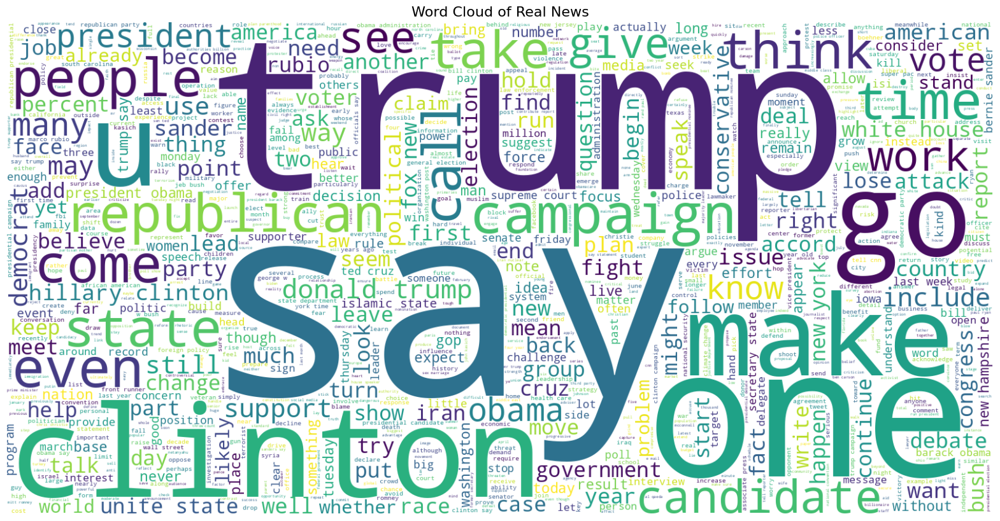

In [17]:
real_news_df	=	df_temp[df_temp['label']	==	'REAL']
real_news	=	'	'.join(real_news_df['clean_news'].astype(str))

wc	=	WordCloud(
    max_words=1000,
    width=1600,
    height=800,
    background_color='white',
    colormap='viridis'
).generate(real_news)

plt.figure(figsize=(20,	20))
plt.axis('off')
plt.title("Word Cloud of Real News",	fontsize=16)
plt.imshow(wc,	interpolation='bilinear')
plt.show()

### WordCloud of Fake News

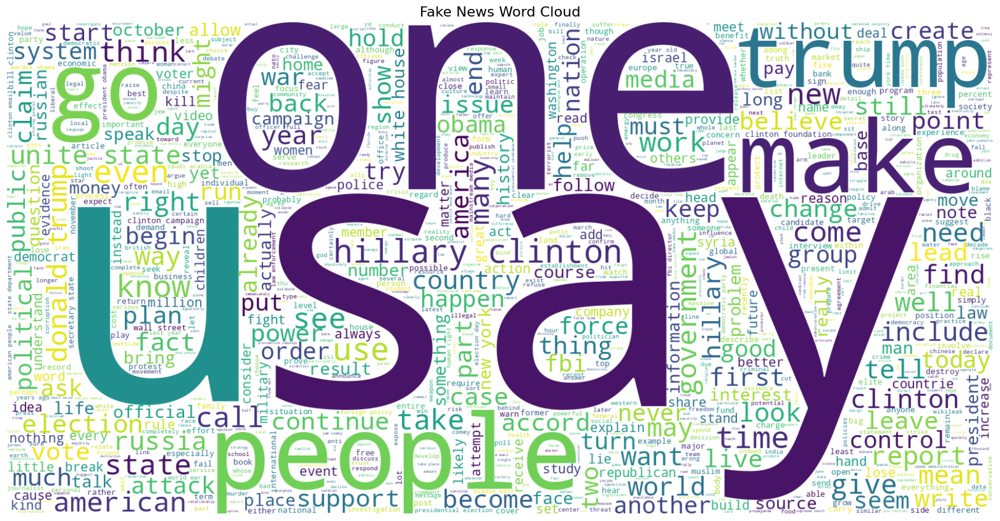

In [18]:
fake_news_df	=	df_temp[df_temp['label']	==	'FAKE']
fake_news	=	'	'.join(fake_news_df['clean_news'].astype(str))

wc = WordCloud(
    max_words=1000,
    width=1600,
    height=800,
    background_color='white',
    colormap='viridis'
).generate(fake_news)

plt.figure(figsize=(20,	20))
plt.axis('off')
plt.title("Fake News Word Cloud",	fontsize=16)
plt.imshow(wc,	interpolation='bilinear')
plt.show()

## Split data

In [19]:
# Set data dan target
X = df_temp['clean_news']
y = df['label'].map({'REAL': 0, 'FAKE': 1})

In [20]:
# Train dan test data split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [21]:
print(f"X_train shape: {X_train.shape}")
print(f"y_train shape: {y_train.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"y_test shape: {y_test.shape}")

X_train shape: (5068,)
y_train shape: (5068,)
X_test shape: (1267,)
y_test shape: (1267,)


## Vectorization

In [29]:
vector = TfidfVectorizer()
X_train_vect = vector.fit_transform(X_train)
X_test_vect = vector.transform(X_test)

In [30]:
vocabulary = vector.get_feature_names_out()

In [31]:
df_train_tfidf = pd.DataFrame(X_train_vect.toarray(), columns=vocabulary)

In [34]:
from google.colab import data_table
data_table.DataTable(df_train_tfidf, include_index=False)  # Menghilangkan index agar lebih rapi

,aa,aaa,aaahhh,aaas,aab,aachen,aadhar,aadmi,aae,aaeeb,aah,aaib,aaingr,aaj,aakar,aakhri,aalia,aall,aaluijqn,aam,aamaq,aamon,aaojejptcy,aap,aapke,aapko,aapne,aaron,aaronapollocamp,aarondmiller,aaronson,aarp,aart,aaso,aata,aaye,aayush,aaza,ab,aba,abaaoud,ababa,aback,abad,abadi,abaldo,aban,abandon,abandonment,abandonnig,abate,abatement,abay,abayas,abbar,abbas,abbe,abbey,abbn,abbot,abbott,abbottabad,abbreviate,abbreviation,abbreviations,abby,abc,abcnews,abcpolitics,abd,abdallah,abdel,abdelhamid,abdelmoumen,abdeslam,abdicate,abdication,abdikadir,abdirashid,abdkir,abdollah,abdollahi,abdomen,abdominal,abdrabbuh,abduct,abductee,abductees,abduction,abductions,abductor,abdul,abdulazeez,abdulaziz,abdulghani,abdulla,abdullah,abdullahuniversity,abdulmutallab,abdulrahman,abdulzai,abdur,abdurrahman,abdus,abe,abed,abedin,abedine,abedini,abedins,abednego,abeille,abel,abelah,abeldanger,abercrombie,abernathy,abernethy,aberrant,aberration,aberrational,aberrations,abeslam,abet,abetment,abettors,abhijit,abhiram,abhor,abhorrent,abi,abidance,abide,abigail,abilene,abilities,ability,abiotic,abitter,abject,abjectly,abjure,abla,ablaze,able,abled,ableism,ablow,ably,abm,abner,abnormal,abnormalities,abnormalization,abnormally,aboard,abolish,abolishment,abolition,abolitionist,abominable,abomination,abominations,abood,aboriginal,aboriginals,aborigine,aborigines,abort,abortion,abortionist,abortionists,abortions,abortive,abortively,abotsway,abott,abound,abourezk,aboutface,aboutmedia,aboutthe,abouzar,aboveboard,abovementioned,abraham,abrahamic,abrahams,abram,abramoff,abramovic,abramowitz,abrams,abrasive,abravealabamaatheist,abreast,abridge,abroad,abrogate,abrogation,abrupt,abruptly,abruptness,abs,absalon,abscond,absence,absences,absent,absentee,absenteeism,absentia,absolute,absolutely,absolutes,absolution,absolutist,absolutley,absolve,absorb,absorbable,absorbers,absorption,absorptive,abstain,abstention,abstentionism,abstentions,abstract,abstraction,abstractions,abstruse,absurd,absurdist,absurdities,absurdity,absurdly,abt,abu,abuirshaid,abuja,abunasir,abundance,abundant,abundantly,abuse,abusers,abusive,abut,abuzz,abyad,abysmal,abysmally,abyss,abyssal,abysses,abzug,ac,aca,acab,academe,academi,academia,academic,academically,academicians,academics,academies,academy,acai,acars,acccgwmfcwkibwmffqojcasffgidaqachgecf,accede,accelerant,accelerate,acceleration,accelerator,accent,accentuate,accept,acceptability,acceptable,acceptance,acceptances,acceso,access,accessibility,accessible,accession,accessories,accessorized,accessory,accident,accidental,accidentally,accidently,accidents,acclaim,acclamation,acclimate,accolades,accomazzo,accommodate,accommodation,accommodations,accommodative,accompaniment,accompany,accompli,accomplice,accomplices,accomplis,accomplish,accomplishment,accomplishments,accomulating,accord,accordance,accordant,accordingly,accordion,accostomed,account,accountability,accountable,accountant,accountants,accouter,accredit,accrete,accretion,accrual,accrue,acculturate,accumulate,accumulation,accuracy,accurate,accurately,accusation,accusations,accusatory,accuse,accuser,accusers,accustom,accuweather,ace,acela,acerbate,acerbic,acetaminophen,acetone,acevedo,acfe,achairman,achanak,ache,achen,acheron,acheson,achievable,achieve,achievement,achievements,achievers,achille,achilles,achuar,acid,acidic,acidification,acidity,acidly,acids,acierto,ackbar,acker,ackerman,acklam,acknowledge,acknowledgement,acknowledgements,acknowledgment,acknowledgments,acls,aclu,acme,acn,acolyte,acolytes,acorn,acorns,acos,acosmin,acosta,acoustic,acp,acquaint,acquaintance,acquaintances,acquiesce,acquiescence,acquire,acquirer,acquisition,acquisitions,acquisitive,acquit,acquittal,acquittals,acr,acre,acreage,acres,acrid,acrimonious,acrimoniously,acrimony,acrobat,acrobatic,acrobatics,acrobats,acronym,acronyms,across,acrossmediums,acrylic,acs,act,actasia,action,actionable,actionevent,actionlistener,actionperformed,activate,activation,active,actively,activism,activist,activistpost,activists,activities,

### Make pickle file for vectorization

In [ ]:
pickle.dump(vector, open('vectorizer.pkl', 'wb'))

# Modeling

In [ ]:
def	classification_eval(aktual,	prediksi,	name):
  cm	=	confusion_matrix(aktual,	prediksi)

  #	plot	confusion	matrix
  plt.figure(figsize=(8,6))
  sns.heatmap(cm,	annot=True,	fmt="d",	cmap="Blues",	cbar=False,
              xticklabels=['Predicted Negative',	'Predicted Positive'],
              yticklabels=['Actual Negative',	'Actual Positive'])
  plt.xlabel('Predicted Labels')
  plt.ylabel('Actual Labels')
  plt.title(f'Confusion Matrix - {name}')
  plt.show()

  print(classification_report(aktual,	prediksi, digits=4))

## Naive Bayes

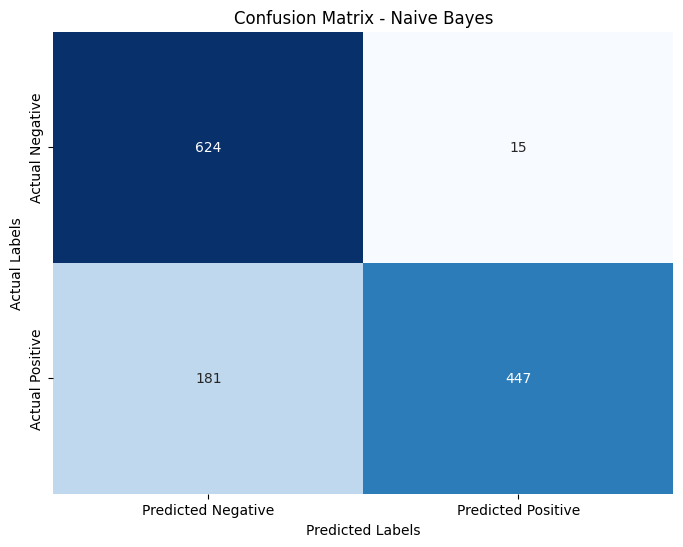

              precision    recall  f1-score   support

           0     0.7752    0.9765    0.8643       639
           1     0.9675    0.7118    0.8202       628

    accuracy                         0.8453      1267
   macro avg     0.8713    0.8442    0.8422      1267
weighted avg     0.8705    0.8453    0.8424      1267



In [ ]:
nb_model = MultinomialNB()
nb_model.fit(X_train_vect,	y_train)
y_pred_nb	=	nb_model.predict(X_test_vect)
classification_eval(y_test,	y_pred_nb,	'Naive Bayes')

## Random Forest

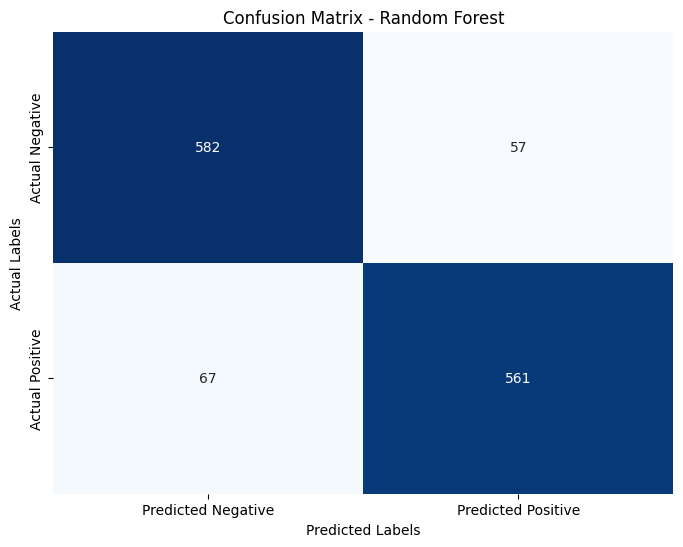

              precision    recall  f1-score   support

           0     0.8968    0.9108    0.9037       639
           1     0.9078    0.8933    0.9005       628

    accuracy                         0.9021      1267
   macro avg     0.9023    0.9021    0.9021      1267
weighted avg     0.9022    0.9021    0.9021      1267



In [ ]:
rf_model = RandomForestClassifier()
rf_model.fit(X_train_vect, y_train)
y_pred_rf = rf_model.predict(X_test_vect)
classification_eval(y_test, y_pred_rf, 'Random Forest')

## K-Nearest Neighbours

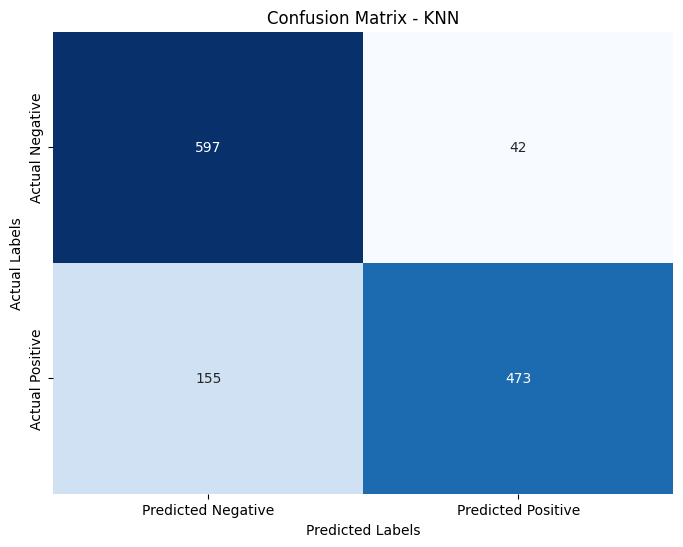

              precision    recall  f1-score   support

           0     0.7939    0.9343    0.8584       639
           1     0.9184    0.7532    0.8276       628

    accuracy                         0.8445      1267
   macro avg     0.8562    0.8437    0.8430      1267
weighted avg     0.8556    0.8445    0.8431      1267



In [ ]:
knn_model	=	KNeighborsClassifier()
knn_model.fit(X_train_vect,	y_train)
y_pred_knn	=	knn_model.predict(X_test_vect)
classification_eval(y_test, y_pred_knn, 'KNN')

## Logistic Regression

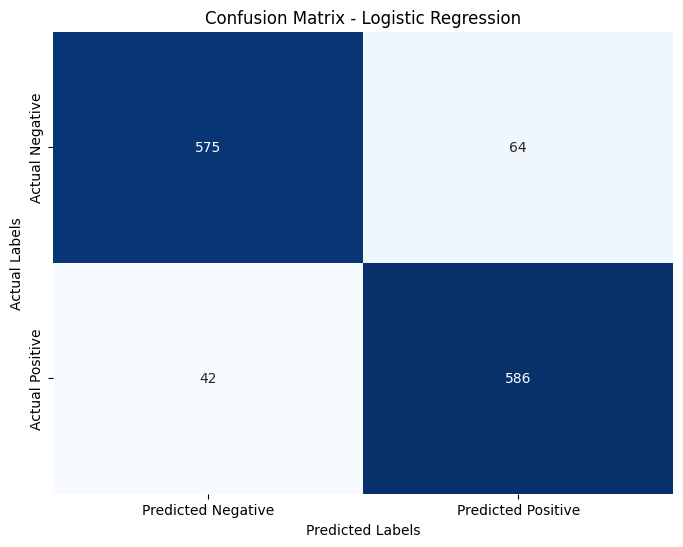

              precision    recall  f1-score   support

           0     0.9319    0.8998    0.9156       639
           1     0.9015    0.9331    0.9171       628

    accuracy                         0.9163      1267
   macro avg     0.9167    0.9165    0.9163      1267
weighted avg     0.9169    0.9163    0.9163      1267



In [ ]:
lr_model	=	LogisticRegression()
lr_model.fit(X_train_vect,	y_train)
y_pred_lr	=	lr_model.predict(X_test_vect)
classification_eval(y_test, y_pred_lr, 'Logistic Regression')

## Support Vector Classification

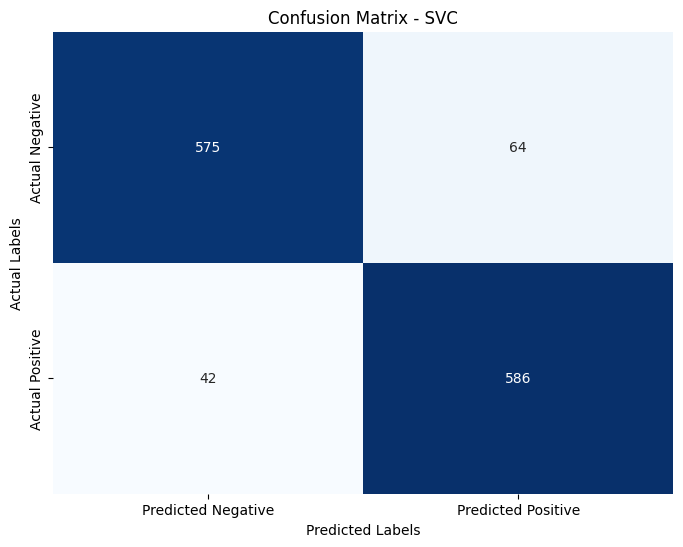

              precision    recall  f1-score   support

           0     0.9319    0.8998    0.9156       639
           1     0.9015    0.9331    0.9171       628

    accuracy                         0.9163      1267
   macro avg     0.9167    0.9165    0.9163      1267
weighted avg     0.9169    0.9163    0.9163      1267



In [ ]:
svc_model	=	LogisticRegression()
svc_model.fit(X_train_vect,	y_train)
y_pred_svc	=	svc_model.predict(X_test_vect)
classification_eval(y_test, y_pred_svc, 'SVC')

Model dengan akurasi tertinggi adalah: Logistic Regression dan Support Vector Classification (92%)

# Model Tunning

* Melakukan model tunning terhadap model dengan akurasi tertinggi

## Logistic Regression

In [ ]:
lr_optimization = LogisticRegression()

parameters = {'C': [0.1, 1, 10, 100, 1000, 10000],
               'solver': ['lbfgs', 'liblinear', 'newton-cg'],
               'max_iter': [100, 1000]}

grid_search = GridSearchCV(estimator=lr_optimization, param_grid=parameters, cv=3, verbose=2)
grid_search.fit(X_train_vect, y_train)
print(f"Best Parameters: {grid_search.best_params_}")

Fitting 3 folds for each of 36 candidates, totalling 108 fits
[CV] END ..................C=0.1, max_iter=100, solver=lbfgs; total time=   0.2s
[CV] END ..................C=0.1, max_iter=100, solver=lbfgs; total time=   0.1s
[CV] END ..................C=0.1, max_iter=100, solver=lbfgs; total time=   0.2s
[CV] END ..............C=0.1, max_iter=100, solver=liblinear; total time=   0.1s
[CV] END ..............C=0.1, max_iter=100, solver=liblinear; total time=   0.1s
[CV] END ..............C=0.1, max_iter=100, solver=liblinear; total time=   0.1s
[CV] END ..............C=0.1, max_iter=100, solver=newton-cg; total time=   0.2s
[CV] END ..............C=0.1, max_iter=100, solver=newton-cg; total time=   0.1s
[CV] END ..............C=0.1, max_iter=100, solver=newton-cg; total time=   0.1s
[CV] END .................C=0.1, max_iter=1000, solver=lbfgs; total time=   0.1s
[CV] END .................C=0.1, max_iter=1000, solver=lbfgs; total time=   0.4s
[CV] END .................C=0.1, max_iter=1000,

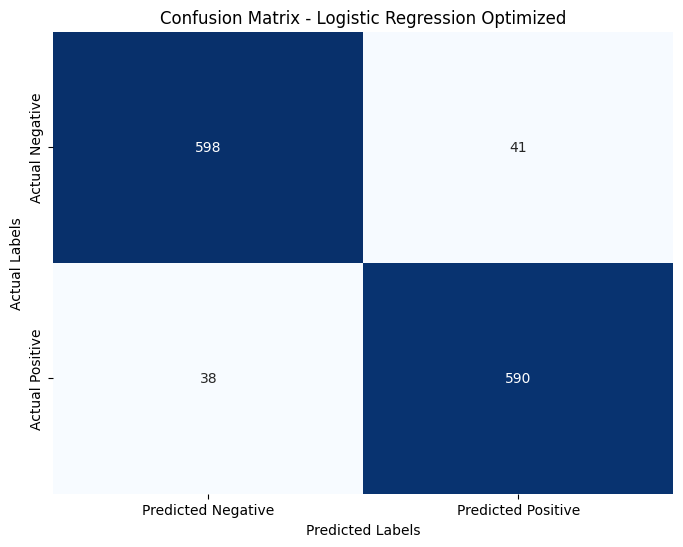

              precision    recall  f1-score   support

           0     0.9403    0.9358    0.9380       639
           1     0.9350    0.9395    0.9373       628

    accuracy                         0.9376      1267
   macro avg     0.9376    0.9377    0.9376      1267
weighted avg     0.9377    0.9376    0.9376      1267



In [ ]:
lr_2	=	LogisticRegression(C=10000,	max_iter=100,	solver='newton-cg')
lr_2.fit(X_train_vect,	y_train)
y_pred_lr_2	=	lr_2.predict(X_test_vect)
classification_eval(y_test,	y_pred_lr_2,	'Logistic Regression Optimized')

## Support Vector Classifier

In [ ]:
svc_optimization = SVC()

parameters = {'C': [0.1, 1, 10, 100],
              'gamma': ['scale', 'auto'],
              'kernel': ['linear', 'rbf']}

grid_search = GridSearchCV(estimator=svc_optimization, param_grid=parameters, cv=3, verbose=2)
grid_search.fit(X_train_vect, y_train)
print(f"Best Parameters: {grid_search.best_params_}")

Fitting 3 folds for each of 16 candidates, totalling 48 fits
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=  22.7s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=  23.6s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=  23.9s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=  28.6s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=  28.7s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=  29.2s
[CV] END ...................C=0.1, gamma=auto, kernel=linear; total time=  22.9s
[CV] END ...................C=0.1, gamma=auto, kernel=linear; total time=  23.2s
[CV] END ...................C=0.1, gamma=auto, kernel=linear; total time=  23.4s
[CV] END ......................C=0.1, gamma=auto, kernel=rbf; total time=  31.1s
[CV] END ......................C=0.1, gamma=auto, kernel=rbf; total time=  31.0s
[CV] END ......................C=0.1, gamma=auto

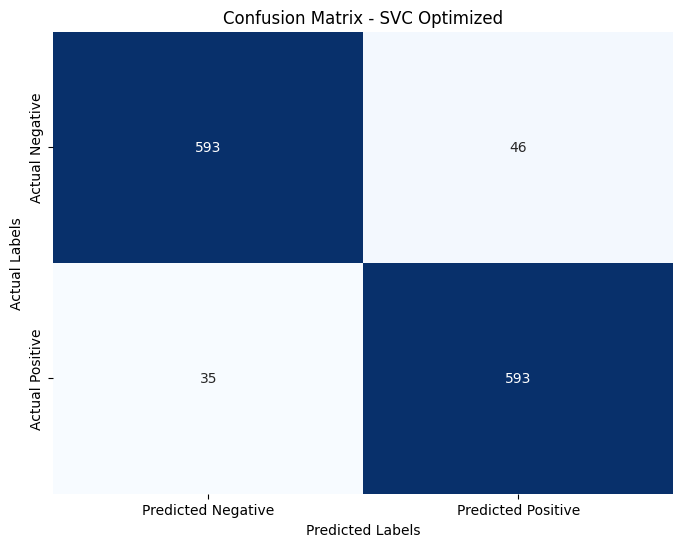

              precision    recall  f1-score   support

           0     0.9443    0.9280    0.9361       639
           1     0.9280    0.9443    0.9361       628

    accuracy                         0.9361      1267
   macro avg     0.9361    0.9361    0.9361      1267
weighted avg     0.9362    0.9361    0.9361      1267



In [ ]:
svc_2	=	SVC(C=1,	gamma='scale',	kernel='linear')
svc_2.fit(X_train_vect,	y_train)
y_pred_svc_2	=	svc_2.predict(X_test_vect)
classification_eval(y_test,	y_pred_svc_2,	'SVC Optimized')

# Make pickle file for best model

In [ ]:
pickle.dump(lr_2,	open('model.pkl',	'wb'))